In [6]:
# general
import os
BASE_DIR = os.path.dirname(os.path.dirname(os.path.abspath('__file__')))

from pathlib import Path

# computation
import pandas as pd

# plotting
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [7]:
stations = [
    'Battambang', 'Chaktomuk', 'Kg._Thmar', 'Koh_Khel', 'Kompong_Cham', 'Kompong_Chen', 'Kompong_Kdei', 'Kompong_Thom',
    'Kratie', 'Lumphat', 'Neak_Luong', 'Phnom_Penh_Port', 'Prek_Kdam', 'Siempang', 'Sisophon', 'Stung_Treng', 'Voeun_Sai',
]

no_fit_stations = ['Phnom_Penh_Port', 'Prek_Kdam']

In [8]:
Path(f'{BASE_DIR}/spt_vs_mrc/').mkdir(parents=True, exist_ok=True)

dfs = []

for station in stations:
    obs = pd.read_csv(f'{BASE_DIR}/mrc_observations/{station}.csv')
    obs['datetime'] = pd.to_datetime(obs['datetime'])

    pred = pd.read_csv(f'{BASE_DIR}/spt_predictions/{station}.csv')
    pred['datetime'] = pd.to_datetime(obs['datetime'])

    obs = obs.rename(columns={'discharge': 'observation'})
    pred = pred.rename(columns={'discharge': 'prediction'})
    df = pd.merge(obs, pred, how='inner', on='datetime')
    df.sort_values(by=['datetime'], ascending=True, inplace=True)
    dfs.append({'station': station, 'df': df})

    df.to_csv(f'{BASE_DIR}/spt_vs_mrc/{station}.csv', encoding='utf-8', index=False)

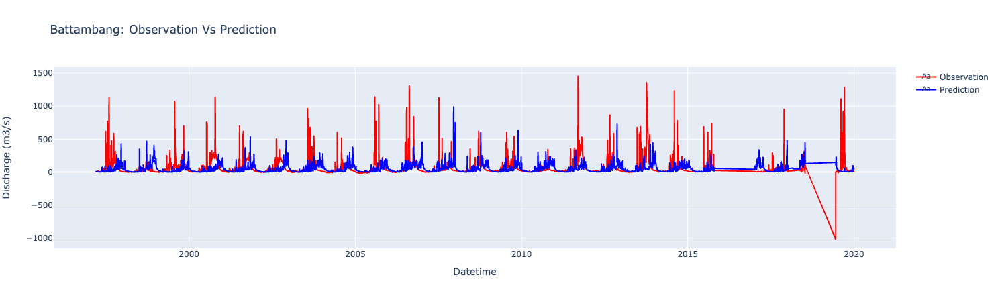

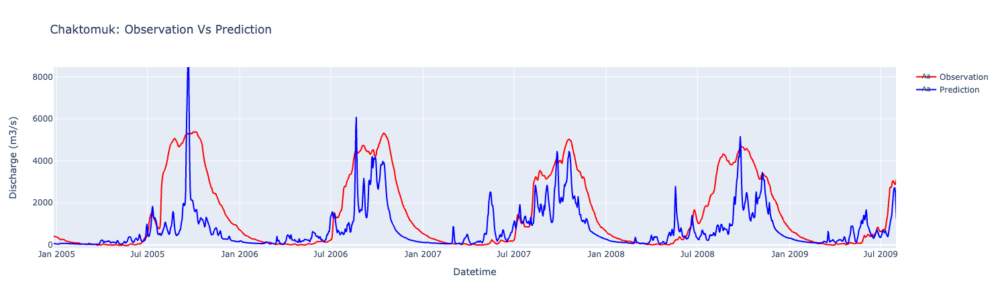

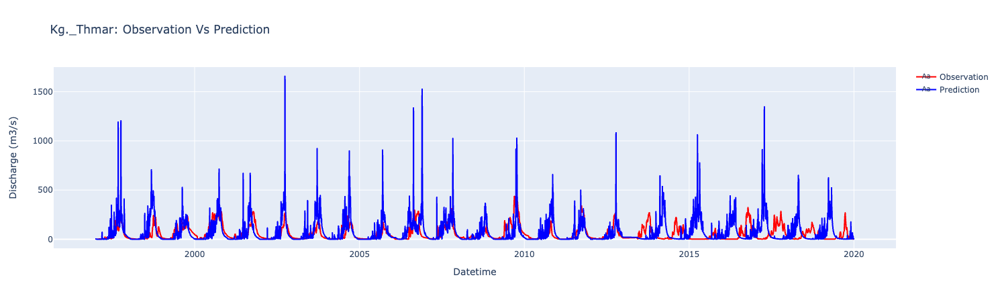

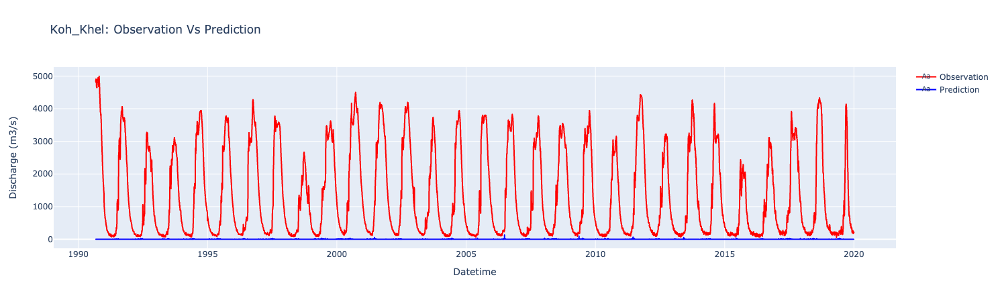

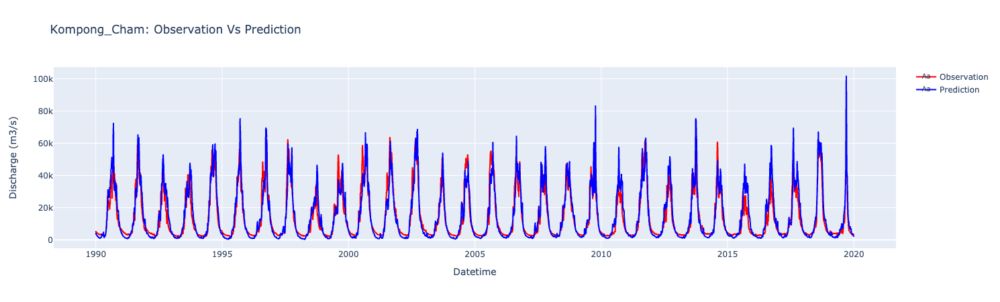

...

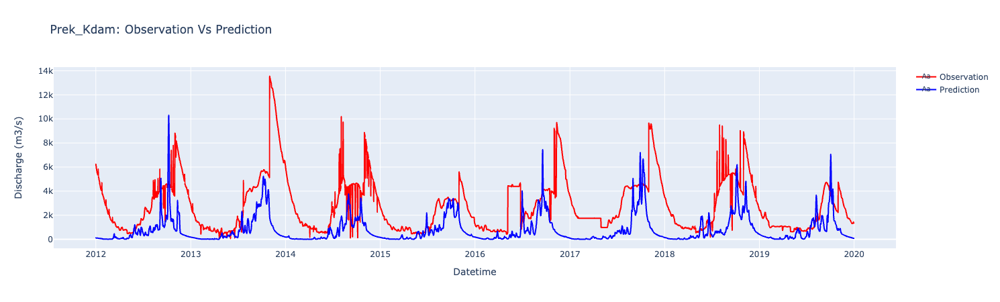

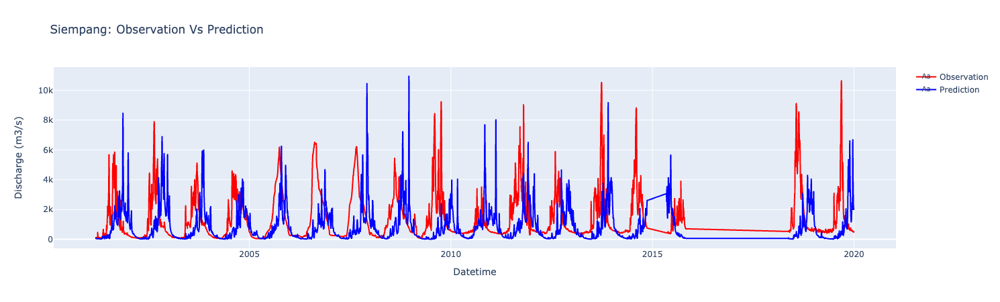

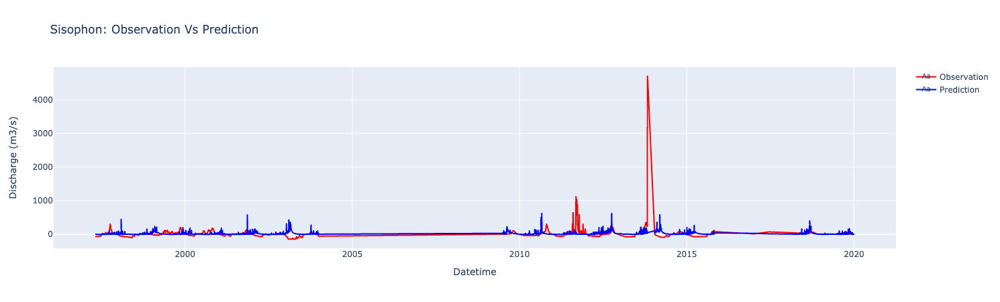

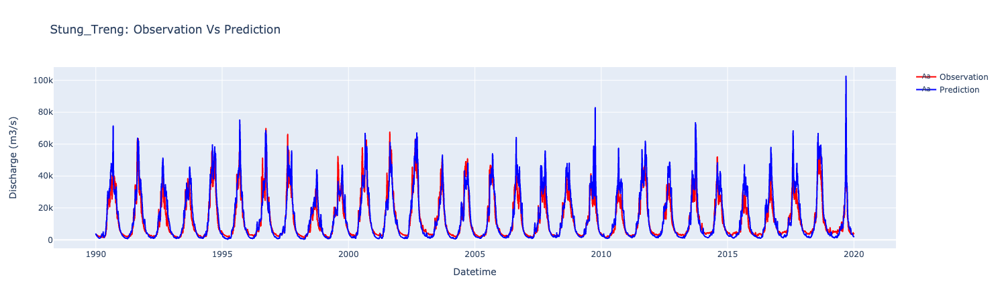

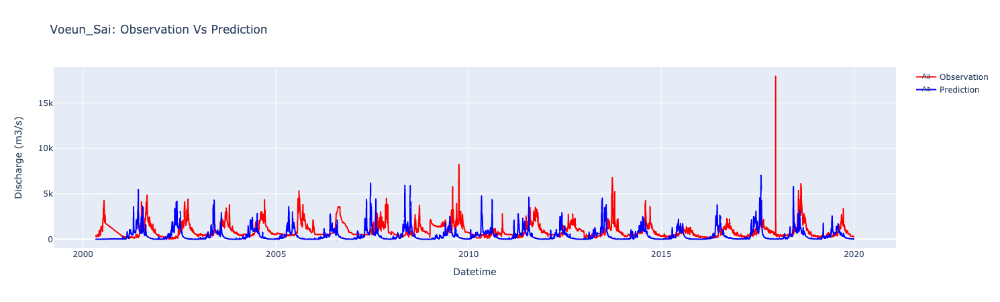

In [9]:
Path(f'{BASE_DIR}/plot_exports/obs_vs_pred/').mkdir(parents=True, exist_ok=True)

for _df in dfs:
    station = _df['station']
    df = _df['df']

    observation = go.Scattergl(x=df.datetime,
                               y=df.observation,
                               mode='lines+text',
                               name = f'Observation',
                               line=dict(color='red'),
                               showlegend=True,
                              )

    prediction = go.Scattergl(x=df.datetime,
                              y=df.prediction,
                              mode='lines+text',
                              name = f'Prediction',
                              line=dict(color='blue'),
                              showlegend=True,
                             )


    layout = go.Layout(title=f'{station}: Observation Vs Prediction',
                       xaxis=dict(title='Datetime'),
                       yaxis=dict(title='Discharge (m3/s)'),
                       showlegend=True)

    fig = go.Figure(data=[observation, prediction], layout=layout)

    fig.write_image(f'{BASE_DIR}/plot_exports/obs_vs_pred/{station}.png')

    fig.show()